
# Comparison of Gillespie Samples  to the Analytical Solutions for the BID Process Family


In this notebook, we compare the analytical expressions from: *Comparing exact and approximate solutions to a stochastic process model of clone size distribution* to resulting distributions from sampled trajectories with the Gillespie algorithm. We will go through the lattice of limiting cases of the BID process in order to check our analytical solutions.

In [2]:
#Required packages
using EvolutionaryModels
using DifferentialEquations
using Plots
using LaTeXStrings

## Pure Immigration Process or Poison

The pure immigration process is the basis for the arrival of a mutant clone to the tumor population. While the process itself presumes that mutants belong to a class and are not unique, with the adequate parameters it might be possible to still have it as an approximate processs.

In [3]:
# Kinetic constants and initial conditions
K_i = (2.8)
N_0 = 0
t = 18.0
pure_immigration

LoadError: MethodError: no method matching create_array(::Type{Float64}, ::Type{Float64}, ::Val{1}, ::Val{1}, ::Float64)
[0mClosest candidates are:
[0m  create_array([91m::Type{<:StaticArraysCore.MArray}[39m, ::Any, ::Val, ::Val{dims}, ::Any...) where dims at ~/.julia/packages/SymbolicUtils/vnuIf/src/code.jl:541
[0m  create_array([91m::Type{<:LabelledArrays.LArray}[39m, ::Any, ::Val, ::Val{dims}, ::Any...) where dims at ~/.julia/packages/SymbolicUtils/vnuIf/src/code.jl:555
[0m  create_array([91m::Type{<:LinearAlgebra.UpperTriangular{T, P}}[39m, ::Any, ::Val, ::Val, ::Any...) where {T, P} at ~/.julia/packages/SymbolicUtils/vnuIf/src/code.jl:523
[0m  ...

In [32]:
# Kinetic constants and initial conditions
K_i = (2.8)
N_0 = 0
t = 18

# Plot some trajectories
prob = DiscreteProblem(pure_immigration, [N_0], (0.0,t), [K_i])
jump_prob = JumpProblem(pure_immigration, prob, Direct())
solutions = EvolutionaryModels.SamplesGillespie(jump_prob,SSAStepper(),100)
trajectories = EvolutionaryModels.solutionstoDF(solutions)
trajectoriesPlot = EvolutionaryModels.plotCRNGillespie(solutions,"Immigration")

In [33]:
# Save
savefig(trajectoriesPlot,"PureImmigration_CRN.pdf")

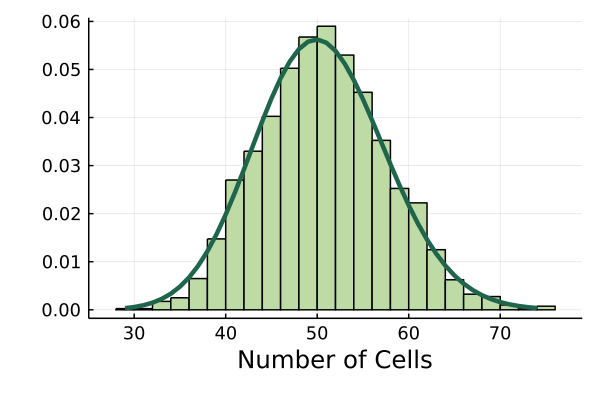

In [40]:
# Let's compare
nmostres = 2000
FinalMostra = EvolutionaryModels.SampleFinal(nmostres,jump_prob,SSAStepper(),1)
Nmin = minimum(FinalMostra[1])
Nmax = maximum(FinalMostra[1])
orange = Nmin:1:Nmax
Distro = EvolutionaryModels.PureImmigration.(K_i,t,orange,N_0)
histogram(FinalMostra[1],normalize = true,xlabel = "Number of Cells",
    thickness_scaling = 1.5,legend = false,color = "#BEDAA5")
plot!(orange,Distro,xlabel = "Number of Cells",thickness_scaling = 1.5,
    legend = false,linewidth=2,
    #title=L" P\left(n,t\right) = \frac{\left(k_I t \right)^n}{n!}e^{-k_It}",
color = "#1F654C",w=3)

In [41]:
# Save
savefig("PureImmigration_Histogram.pdf") 

## Pure Death or Decay Process


In [64]:
# Kinetic constants and initial conditions
K_d = (0.25)
N_0 = 50
t = 10.0

# Plot some trajectories
prob = DiscreteProblem(pure_death, [N_0], (0.0,t), [K_d])
jump_prob = EvolutionaryModels.JumpProblem(pure_death, prob, Direct())
solutions = EvolutionaryModels.SamplesGillespie(jump_prob,SSAStepper(),100)
trajectories = EvolutionaryModels.solutionstoDF(solutions)
EvolutionaryModels.plotCRNGillespie(solutions,"Death")

In [65]:
savefig("PureDeath_CRN.pdf") 

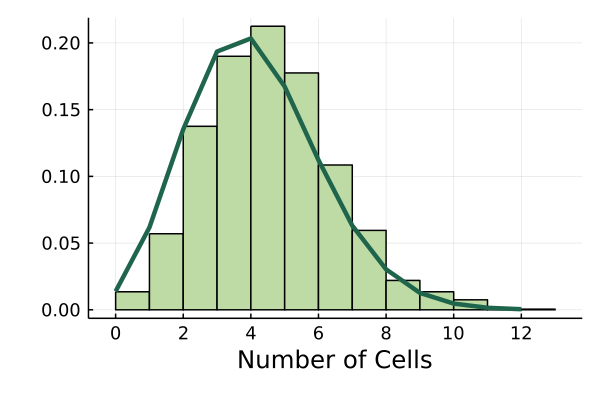

In [72]:
# Let's compare
nmostres = 2000
FinalMostra = EvolutionaryModels.SampleFinal(nmostres,jump_prob,SSAStepper(),1)
Nmin = minimum(FinalMostra[1])
Nmax = maximum(FinalMostra[1])
orange = Nmin:1:Nmax
Distro = EvolutionaryModels.PureDeath.(K_d,t,orange,N_0)
histogram(FinalMostra[1],normalize = true,xlabel = "Number of Cells",thickness_scaling = 1.5,legend = false,
    bins=20,color = "#BEDAA5")
plot!(orange,Distro,xlabel = "Number of Cells",thickness_scaling = 1.5,legend = false,linewidth=2,
    #title=L"\binom{n_0}{n} e^{-n_{0} k_{D} t}\left(1 - e^{-k_{D}t}\right)^{ n_{0}-n}",
    titlefont=font(10,"Computer Modern"),
    color = "#1F654C",w=3)


In [73]:
# Save
savefig("PureDeath_Histogram.pdf") 

## Pure Birth or Yule Process

Pure Birth Comparison

In [57]:
# Kinetic constants and initial conditions
K_b = (0.5)
N_0 = 1
t = 8.0

# Plot some trajectories
prob = DiscreteProblem(pure_birth, [N_0], (0.0,t), [K_b])
jump_prob = JumpProblem(pure_birth, prob, Direct())
solutions = EvolutionaryModels.SamplesGillespie(jump_prob,SSAStepper(),100)
trajectories = EvolutionaryModels.solutionstoDF(solutions)
EvolutionaryModels.plotCRNGillespie(solutions,"Birth")

In [58]:
# Save
savefig("PureBirth_CRN.pdf") 

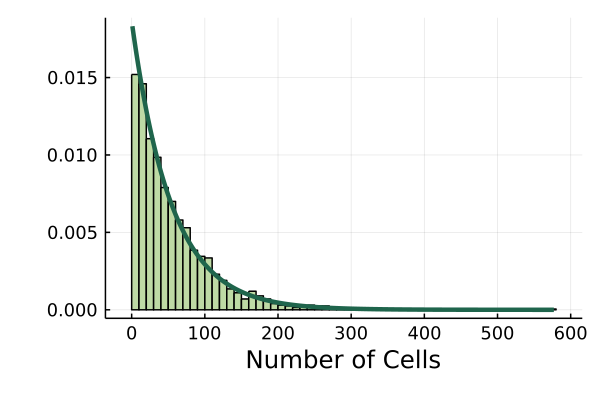

In [60]:
# Let's compare
nmostres = 2000
FinalMostra = EvolutionaryModels.SampleFinal(nmostres,jump_prob,SSAStepper(),1)
Nmin = minimum(FinalMostra[1])
Nmax = maximum(FinalMostra[1])
orange = Nmin:1:Nmax
Distro = EvolutionaryModels.PureBirth.(K_b,t,orange,N_0)
histogram(FinalMostra[1],normalize = true,xlabel = "Number of Cells",thickness_scaling = 1.5,legend = false,
   color = "#BEDAA5")
plot!(orange,Distro,xlabel = "Number of Cells",thickness_scaling = 1.5,legend = false,linewidth=2,
    # title=L"\binom{n - 1}{n - n_{0}} e^{-n_{0} k_{B} (t - t_{0})}\left(1 - e^{-k_{B}(t - t_{0})}\right)^{n - n_{0}}",
    titlefont=font(10,"Computer Modern"),
    color = "#1F654C",w=3)


In [61]:
# Save/""
savefig("PureBirth_Histogram.pdf") 

## Birth-Death Process

In [74]:
K_b = (5.5)
K_d = (4.5)
N_0 = 1
t = 1.0
t_0 = 0.0

prob = DiscreteProblem(birth_death, [N_0], (0.0,t), (K_b,K_d))
jump_prob = JumpProblem(birth_death, prob, Direct())
solutions = EvolutionaryModels.SamplesGillespie(jump_prob,SSAStepper(),100)
trajectories = EvolutionaryModels.solutionstoDF(solutions);

In [75]:
EvolutionaryModels.plotCRNGillespie(solutions,"Birth-Death")
#annotate!(0.48, 35, L"k_D: A \longrightarrow \emptyset", :color)

In [76]:
# Save
savefig("BD_CRN.pdf") 

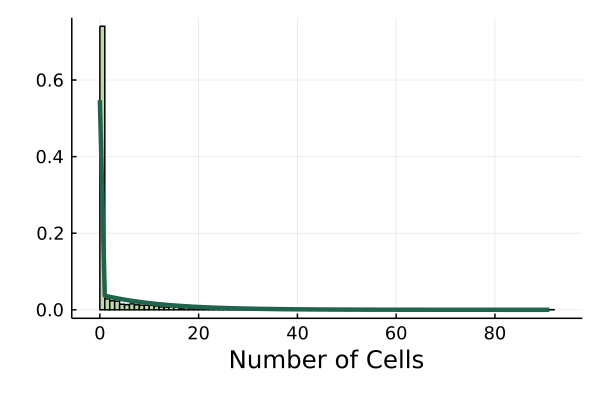

In [85]:
# Let's compare
nmostres = 2000
FinalMostra = EvolutionaryModels.SampleFinal(nmostres,jump_prob,SSAStepper(),1)
Nmin = minimum(FinalMostra[1])
Nmax = maximum(FinalMostra[1])
orange = Nmin:1:Nmax
τ = (K_b-K_d)*(t-t_0)
σ = (K_b-K_d)/(K_b+K_d)
DistroUs = EvolutionaryModels.P_BD(σ,τ,orange,N_0)
histogram(FinalMostra[1],normalize = true,bins=100,  color = "#BEDAA5")
#plot!(orange,Distro)
plot!(orange,DistroUs[1:length(orange)],xlabel = "Number of Cells",thickness_scaling = 1.5,legend = false,linewidth=2,
    title="",
    titlefont=font(10,"Computer Modern"),color = "#1F654C",w=3)

In [86]:
# Save
savefig("BirthDeath_Histogram.pdf") 

## Birth-Death-Immigration Process

In [3]:
K_b = (5.5)
K_d = (4.5)
K_i = (1.0)
N_0 = 1
t = 1.0
t_0 = 0.0

prob = DiscreteProblem(birth_death_immigration, [N_0], (0.0,t), (K_b,K_d,K_i))
jump_prob = JumpProblem(birth_death_immigration, prob, Direct())
solutions = EvolutionaryModels.SamplesGillespie(jump_prob,SSAStepper(),100)
trajectories = EvolutionaryModels.solutionstoDF(solutions);

In [4]:
EvolutionaryModels.plotCRNGillespie(solutions,"Birth-Death-Immigration")

In [5]:
# Save
savefig("BID_CRN.pdf") 

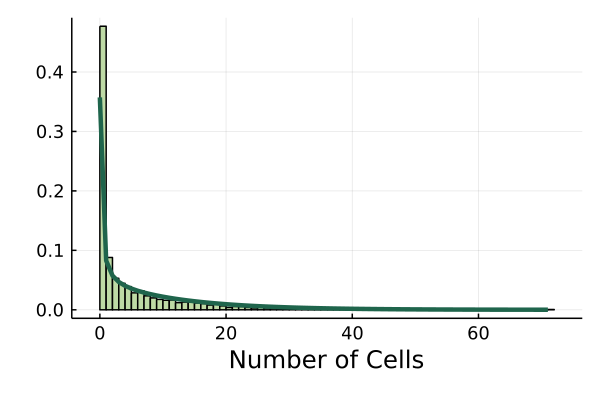

In [7]:
# Let's compare
nmostres = 2000
FinalMostra = EvolutionaryModels.SampleFinal(nmostres,jump_prob,SSAStepper(),1)
Nmin = minimum(FinalMostra[1])
Nmax = maximum(FinalMostra[1])
orange = Nmin:1:Nmax
τ = (K_b-K_d)*(t-t_0)
σ = (K_b-K_d)/(K_b+K_d)
m = K_i/(K_b-K_d)
DistroUs = EvolutionaryModels.P_BID(orange,N_0,t,K_d,K_b,K_i,t_0)
histogram(FinalMostra[1],normalize = true, color = "#BEDAA5")
plot!(orange,DistroUs[1:length(orange)],xlabel = "Number of Cells",thickness_scaling = 1.5,legend = false,linewidth=2,
    #title="Birth-Death-Immigration Process",
    titlefont=font(10,"Computer Modern"),color = "#1F654C",w=3)

In [8]:
# Save
savefig("BirthDeathImmigration_Histogram.pdf") 